# Mean-Squared Displacement #

The mean-squared displacement (MSD) measures deviation in the position of a particle over a given interval of time, $\tau$, with respect to a reference position at time, $t$. It is a common metric used to study diffusion. It is given by:

$$ MSD(\tau) = \langle \Delta \vec{r}(\tau)^2 \rangle = \frac{1}{N_p} \sum_{j=1}^{N_p} \Delta \vec{r}_j(\tau)^2, $$

where $N_p$ is the number of particles in the system and $\Delta \vec{r}_j(t)$ is the displacement of a particle, $j$, over a interval of time, $\tau$, relative to a reference position at time $t$:

$$ \Delta \vec{r}_j(\tau) = \vec{r}_j(t+\tau) - \vec{r}_j(t). $$

The diffusion coefficient, $D$, can be obtained using the Einstein Relation,

$$ 2dD = \lim_{\tau\to\infty} \frac{d}{d\tau} MSD(\tau), $$

where $d$ is the number of dimensions to compute the diffusion coefficient along (in our case, $d=3$).

*Note that the experimentally determined diffusion coefficient of liquid argon at 120K is: $6.17 \times 10^{-5} \; cm^{2} \; sec^{-1}$, from:* 

Jamshid Naghizadeh, Stuart A. Rice. Kinetic Theory of Dense Fluids. X. Measurement and Interpretation of Self‐Diffusion in Liquid Ar, Kr, Xe, and CH4. *J. Chem. Phys.* **1962**, *36*(10): 2710–2720. https://doi.org/10.1063/1.1732357

### Retrieving Data ###

The data from a Lennard-Jones Fluid simulation (using the code we have been developing) is available on Blackboard. The parameters for this simulation were:

- `n_particles=216`
- `temp=120.0`
- `density=0.0291`
- `time_step=0.002`
- `length_of_equilibration=1000`
- `length_of_simulation=10000`
- `write_freq=1`
- `sigma=3.405`
- `epsilon=0.238`
- `mass=0.03994`
- `file_namestem=""`

This data can be read using the following function:

In [1]:
import numpy as np
def readXYZ(filename, stage="both"):
    '''
    Reads an XYZ file (that was written by OutputWriter)

    Parameters
    ----------
    filename : str
        Name of the file to read
    stage : "equilibration", "production", "both"
        Which stage of the simulation to read. Default is "both"

    Returns
    -------
    times : numpy.ndarray(shape=(N_frames,))
        The times at each timestep (in ps)
    frames : numpy.ndarray(shape=(N_frames, N_atoms, 3))
        The data stored in the file for each frame
    '''
    def _floatcheck(str):
        # Check if string is a float
        return str.replace(".", "").replace("-", "").isnumeric()
    
    with open(filename) as file:
        new_frame = True
        frames, times = [], []
        for i, line in enumerate(file.readlines()):
            lc = line.strip().split() # The line contents as a list without leading and trailing whitespace
            if len(lc) == 1 and lc[0].isnumeric():
                natoms = int(lc[0])
                new_frame = True
            elif len(lc) == 4 and _floatcheck(lc[1]) and new_frame:
                if (stage=="both" or (stage=="equilibration" and lc[3]=="(0)") or (stage=="production" and lc[3]=="(1)")): # Check if this line has the time and is in the right stage
                    frames.append(np.zeros((natoms, 3))) # Create empty array to hold this frames positions
                    curr_atom = 0
                    times.append(float(lc[1]))
                    new_frame = False
                else:
                    continue
            elif len(lc) == 4 and _floatcheck(lc[1]) and _floatcheck(lc[2]) and _floatcheck(lc[3]):
                if not new_frame:
                    frames[-1][curr_atom, :] = list(map(float, lc[1:]))
                    curr_atom += 1
            else:
                print(f"Error: Unrecognized line ({i}) of {filename}: {line}")
                break
    return np.array(times), np.array(frames)

***

In [2]:
times, positions = readXYZ(f"unwrapped_positions.xyz", stage="production")

First, let's track several of the particles through time. The following code will do just that:

In [3]:
%%capture

import matplotlib.pyplot as plt # For plotting
import matplotlib.animation as animation # For Lennard Jones Demo
from IPython.display import HTML

def msd_animation():
    fig, ax = plt.subplots(constrained_layout=True)
    path, line, pos = [], [], []
    for ai, c in enumerate(["tab:blue", "tab:orange", "tab:green", "tab:purple"]):
        p, = ax.plot([], [], lw=1, color=c, alpha=0.3)
        path.append(p)
        l, = ax.plot([], [], lw=1, color=c)
        line.append(l)
        ax.scatter(positions[0,ai,0], positions[0,ai,1], color=c, edgecolors="k", marker="o",s=20,clip_on=False, zorder=6)
        po = ax.scatter(positions[0,ai,0], positions[0,ai,1], color=c,marker="o",s=20,clip_on=False, zorder=6)
        pos.append(po)

    ax.set_xlim(np.min(positions[:,:4,0]), np.max(positions[:,:4,0]))
    ax.set_ylim(np.min(positions[:,:4,1]), np.max(positions[:,:4,1]))
    ax.set_ylabel("y")
    ax.set_xlabel("x")

    skip = 10
    def run(i):
        for ai in range(4):
            path[ai].set_data(positions[:i*skip+1,ai,0], positions[:i*skip+1,ai,1])
            line[ai].set_data([positions[0,ai,0], positions[i*skip+1,ai,0]], [positions[0,ai,1], positions[i*skip+1,ai,1]])
            pos[ai].set_offsets((positions[i*skip+1,ai,0], positions[i*skip+1,ai,1]))

    ani = animation.FuncAnimation(fig, run, repeat=False, frames = int(positions.shape[0]/skip)-1, interval=50)
    return ani.to_jshtml()

msdanimated = msd_animation()

In [4]:
HTML(msdanimated)

In [5]:
from numba import njit

@njit
def calc_msd(trajectory, times):
    ''' 
    Calculate the mean squared displacement

    Parameters
    ----------
    trajectory : numpy.ndarray(shape=(n_frames, n_particles, 3))
        The raw positions of the particles (periodic boundary conditions must not be applied)
    times : numpy.ndarray(shape=(n_frames))
        The times of each frame, in ps

    Returns
    -------
    msd : np.ndarray(shape=(np.floor(n_frames/2)))
        The mean squared displacements
    taus : np.ndarray(shape=(np.floor(n_frames/2)))
        The time intervals corresponding to each MSD value in ps
    '''
    n_tau = int(np.floor(trajectory.shape[0]/2))
    msd = np.zeros(n_tau)
    for tau in range(1, n_tau):
        for ts in range(0, trajectory.shape[0]-tau):
            r = trajectory[ts+tau]-trajectory[ts]
            msd[tau] += np.sum(r**2)/r.shape[0]
        msd[tau] = msd[tau]/(trajectory.shape[0]-tau)
    taus = times[:n_tau]-times[0]
    return msd, taus

msd, taus = calc_msd(positions, times)

In [8]:
def calc_msd_diffcoef(msd, taus):
    '''
    Calculate diffusion coefficient from mean squared displacement

    Parameters
    ----------
    msd : np.ndarray(shape=(np.floor(n_frames/2)))
        The mean squared displacement, in Angstroms^2
    taus : np.ndarray(shape=(np.floor(n_frames/2)))
        The time intervals corresponding to each MSD value, in ps
    
    Returns
    -------
    D : float
        Diffusion coefficient in cm^2/sec
    m : float
        The slope of the line of best fit
    b : float
        The y-intercept of the line of best fit
    '''
    m, b = np.polyfit(taus, msd, 1) # Line of best fit to get the slope
    
    # Divide by 2d
    D = m/6
    
    # Now convert to cm^2/sec
    D = D/10000

    return D, m, b

D_msd, m, b = calc_msd_diffcoef(msd[-1000:], taus[-1000:])

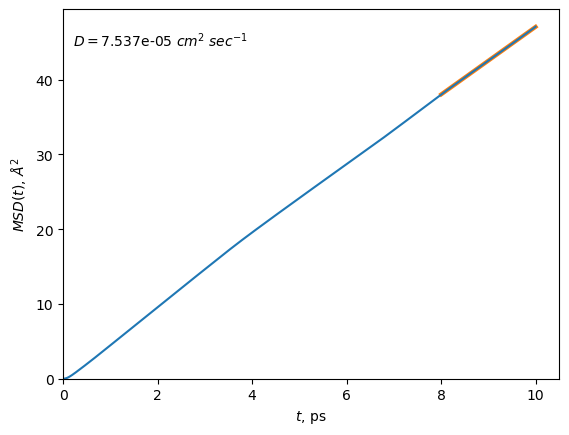

In [9]:
fig, ax = plt.subplots()
ax.plot([taus[-1000], taus[-1]], [m*taus[-1000]+b, m*taus[-1]+b], color="tab:orange", lw=3)
ax.plot(taus, msd, color="tab:blue")
ax.set_ylabel(r"$MSD(t)$, $\AA^2$")
ax.set_xlabel(r"$t$, ps")
ax.annotate(r'$D = $'+f'{D_msd:.3e} '+r'$cm^2\; sec^{-1}$', (0.02,0.9), xycoords='axes fraction', ha='left')
ax.set_xlim(0)
ax.set_ylim(0)
plt.show()